Bài 1

I. Image inverse transformation
G. Gamma-Correction
L. Log Transformation
H. Histogram Equalization
C. Contrast Stretching
E. Exit


Bạn đã chọn Image inverse transformation.


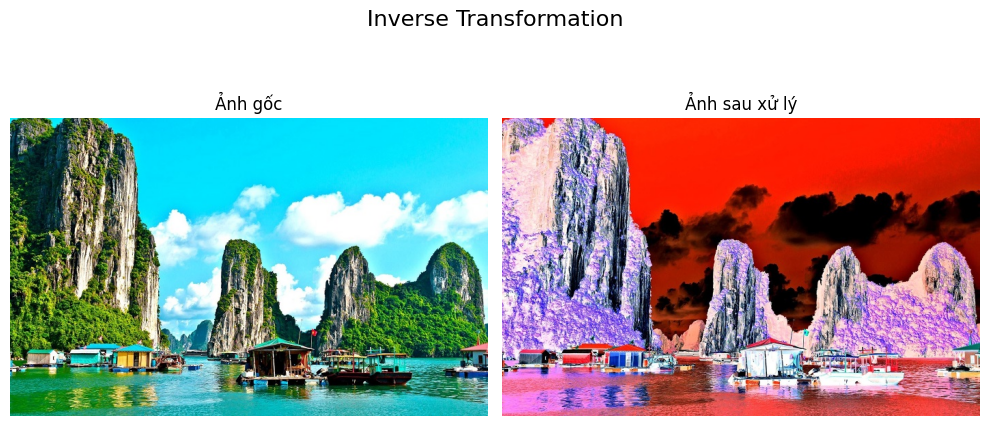

Ảnh đã lưu tại: exercise\inverse_ha-long-bay-in-vietnam.jpg


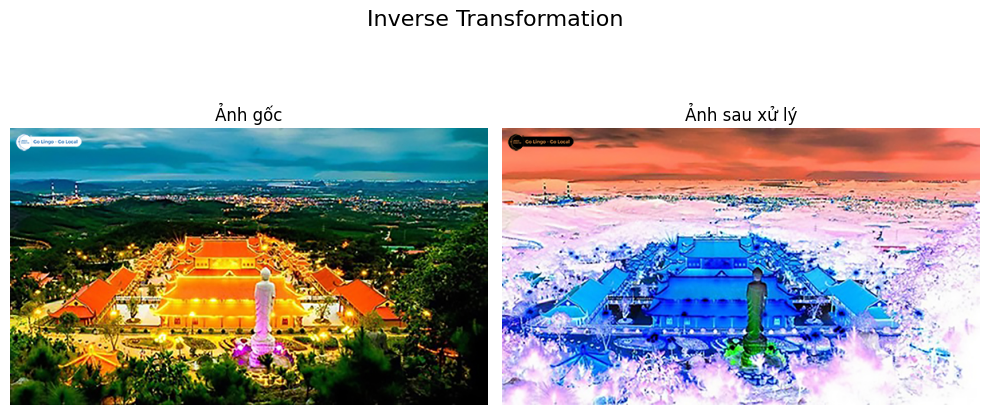

Ảnh đã lưu tại: exercise\inverse_pagoda.jpg


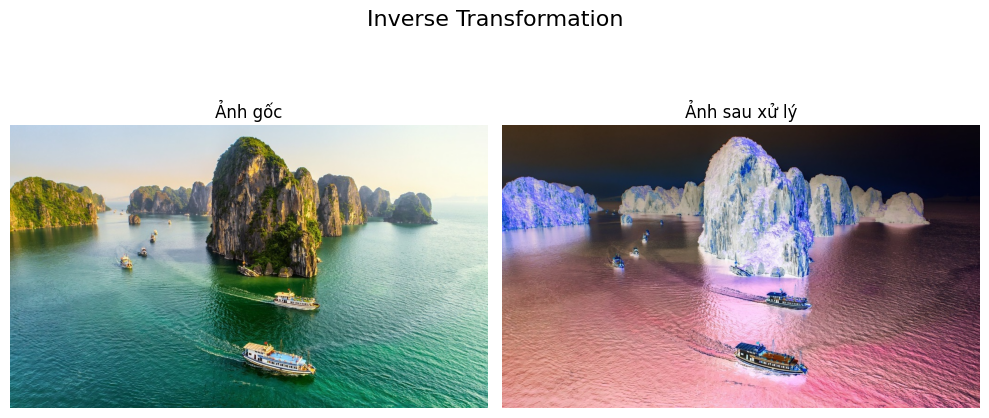

Ảnh đã lưu tại: exercise\inverse_quang_ninh.jpg
I. Image inverse transformation
G. Gamma-Correction
L. Log Transformation
H. Histogram Equalization
C. Contrast Stretching
E. Exit
Bạn đã chọn Gamma-Correction.


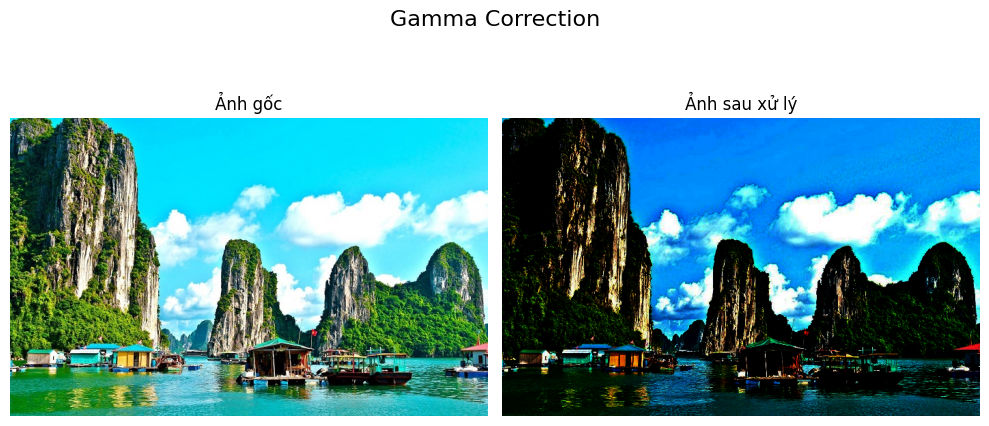

Ảnh đã lưu tại: exercise\gamma_ha-long-bay-in-vietnam.jpg


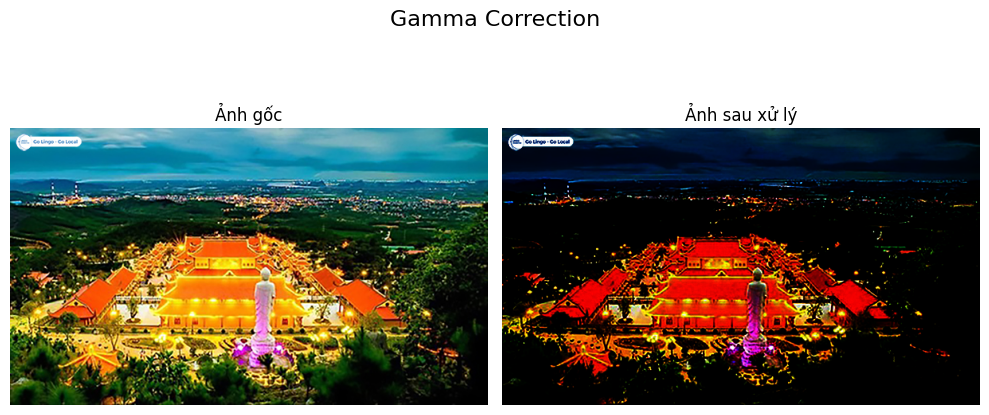

Ảnh đã lưu tại: exercise\gamma_pagoda.jpg


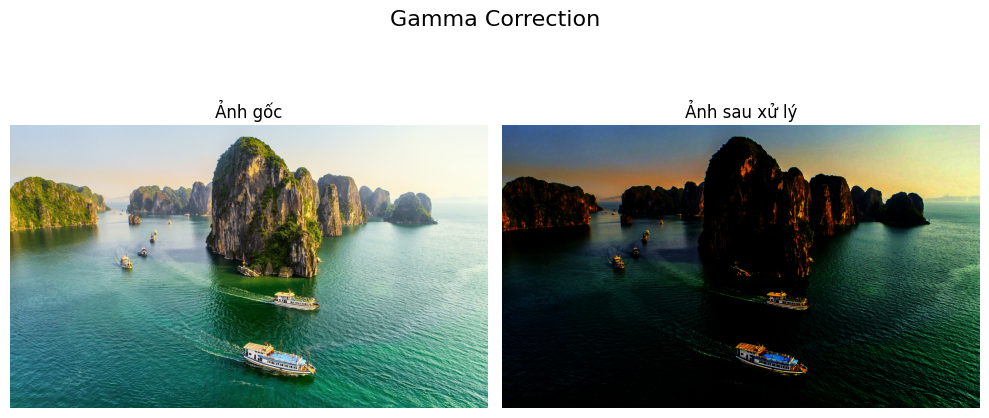

Ảnh đã lưu tại: exercise\gamma_quang_ninh.jpg
I. Image inverse transformation
G. Gamma-Correction
L. Log Transformation
H. Histogram Equalization
C. Contrast Stretching
E. Exit
Bạn đã chọn Histogram Equalization.


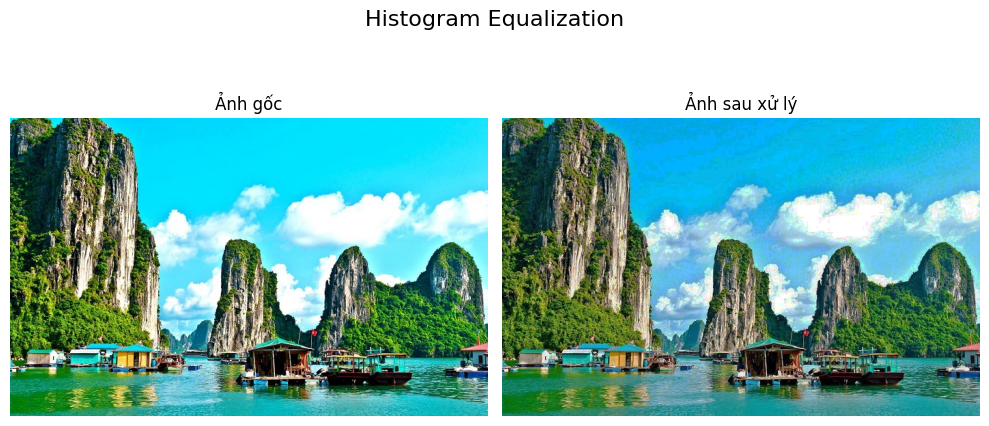

Ảnh đã lưu tại: exercise\equalized_ha-long-bay-in-vietnam.jpg


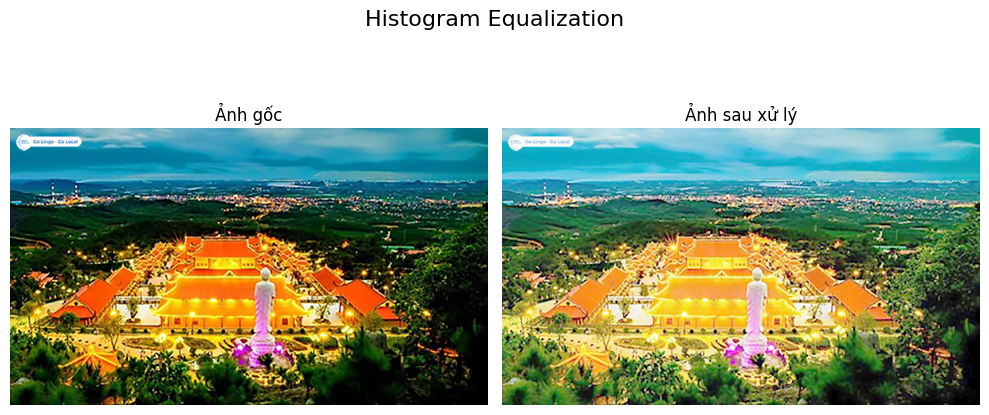

Ảnh đã lưu tại: exercise\equalized_pagoda.jpg


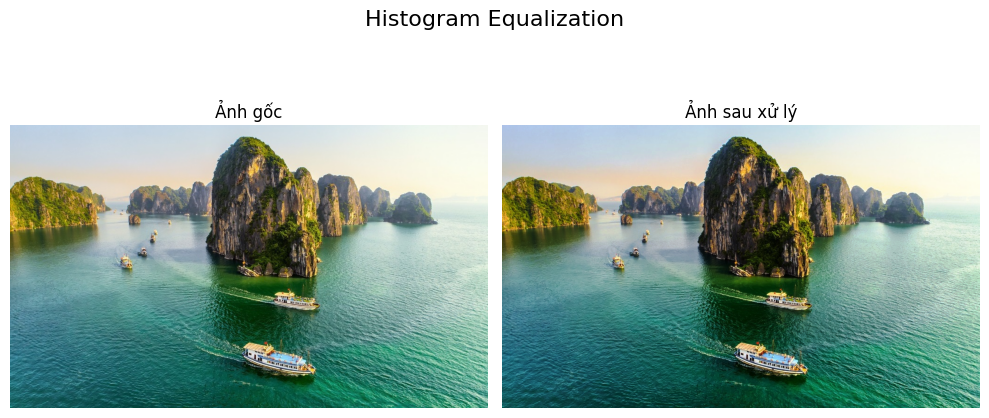

Ảnh đã lưu tại: exercise\equalized_quang_ninh.jpg
I. Image inverse transformation
G. Gamma-Correction
L. Log Transformation
H. Histogram Equalization
C. Contrast Stretching
E. Exit
Bạn đã chọn Log Transformation.


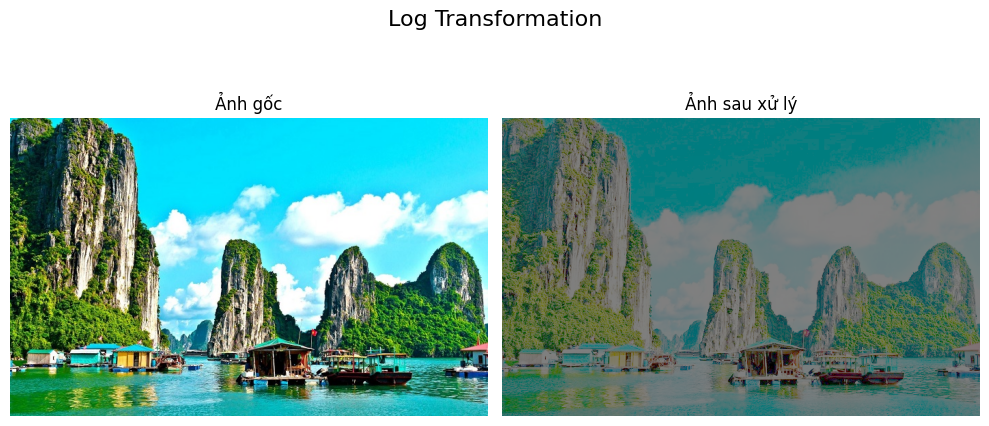

Ảnh đã lưu tại: exercise\log_ha-long-bay-in-vietnam.jpg


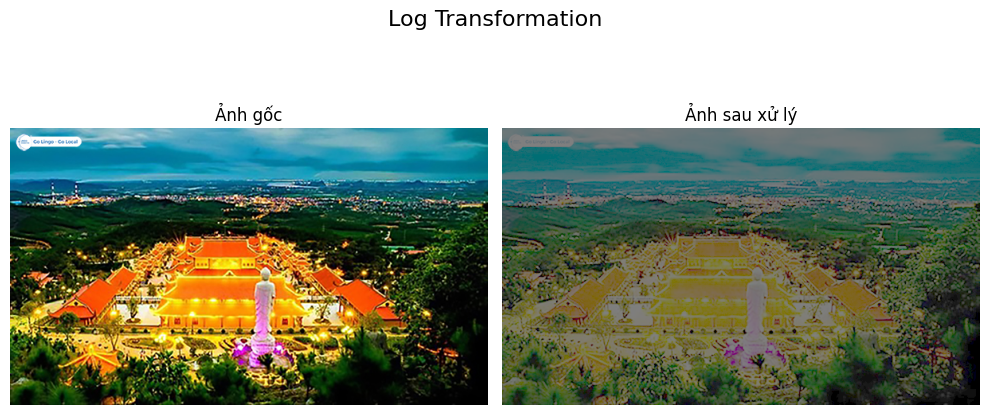

Ảnh đã lưu tại: exercise\log_pagoda.jpg


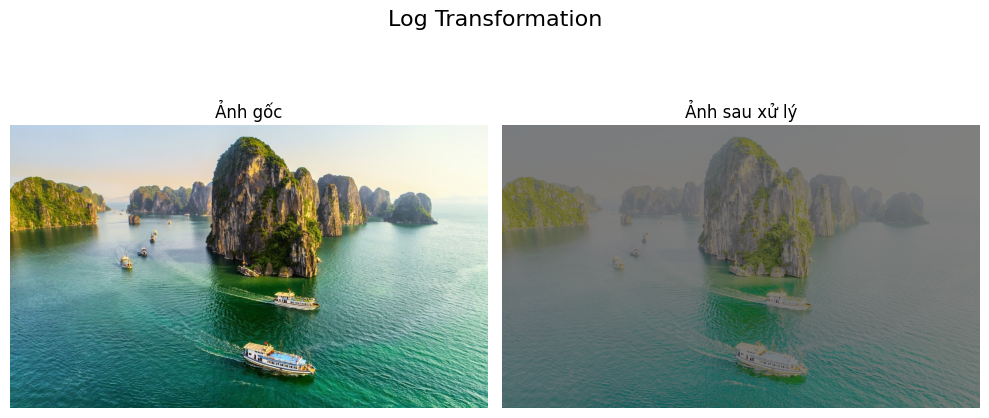

Ảnh đã lưu tại: exercise\log_quang_ninh.jpg
I. Image inverse transformation
G. Gamma-Correction
L. Log Transformation
H. Histogram Equalization
C. Contrast Stretching
E. Exit
Bạn đã chọn Contrast Stretching.


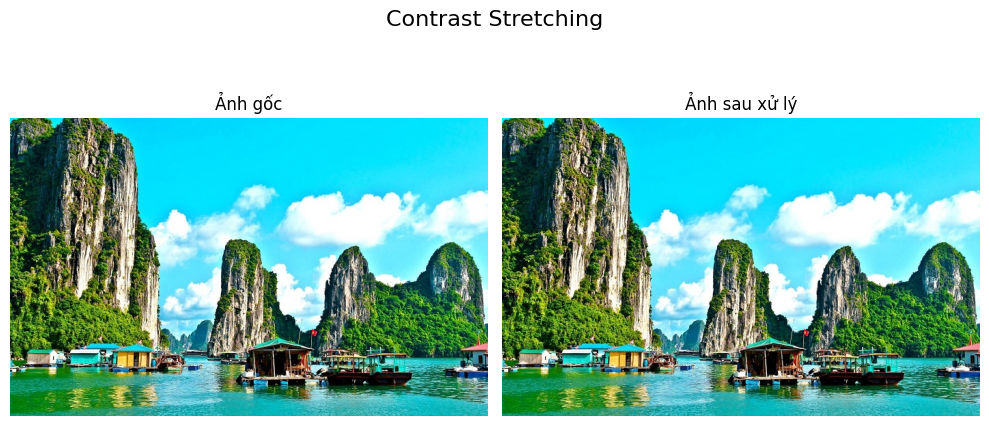

Ảnh đã lưu tại: exercise\contrast_ha-long-bay-in-vietnam.jpg


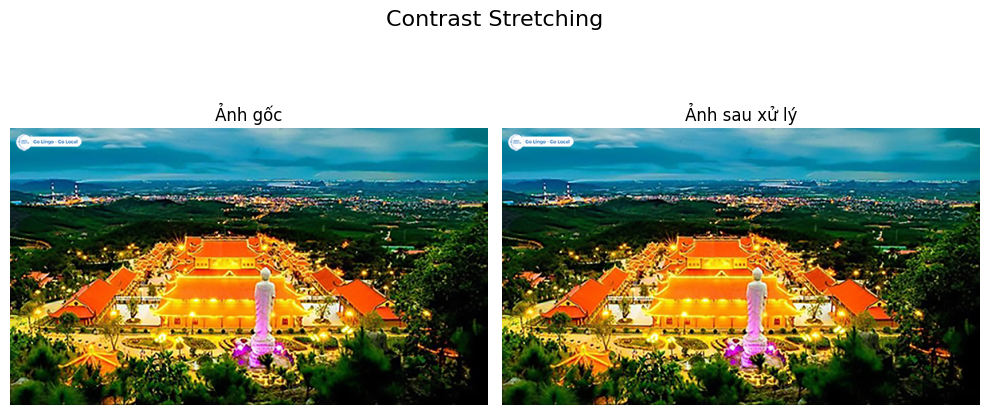

Ảnh đã lưu tại: exercise\contrast_pagoda.jpg


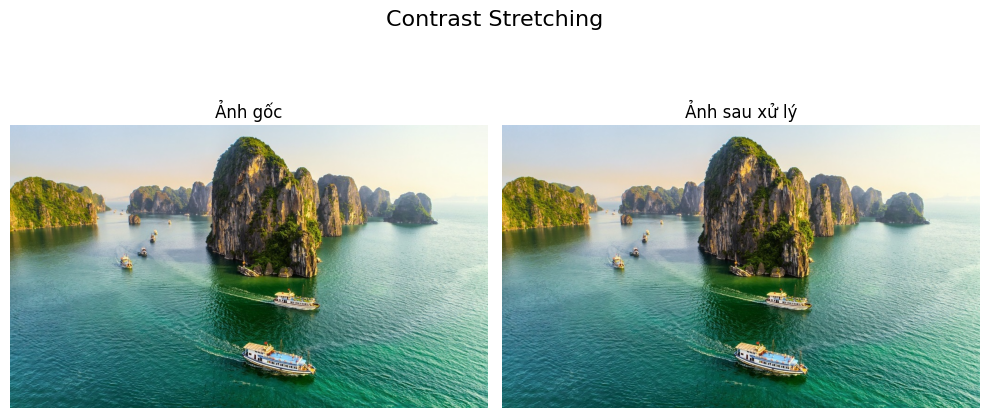

Ảnh đã lưu tại: exercise\contrast_quang_ninh.jpg
I. Image inverse transformation
G. Gamma-Correction
L. Log Transformation
H. Histogram Equalization
C. Contrast Stretching
E. Exit
Bạn đã chọn thoát chương trình.


In [25]:
from PIL import Image
import scipy
import numpy as np
import imageio.v2 as iio
import matplotlib.pyplot as plt
import os

def inverse_image(img_path):
    img = Image.open(img_path)
    im_1 = np.asarray(img)
    im_2 = 255 - im_1
    new_img = Image.fromarray(im_2)
    show_images(img, new_img, "Inverse Transformation")
    save_path = os.path.join("exercise", f"inverse_{os.path.basename(img_path)}")
    iio.imsave(save_path, im_2)
    print(f"Ảnh đã lưu tại: {save_path}")

def gamma_correction(img_path):
    img = Image.open(img_path)
    im_1 = np.asarray(img)
    gamma = 5
    b1 = im_1.astype(float)
    b2 = np.max(b1)
    b3 = b1 / b2
    b2 = np.log(b3 + 1e-8) * gamma  
    c = np.exp(b2) * 255.0
    c1 = np.clip(c, 0, 255).astype(np.uint8)  
    d = Image.fromarray(c1)
    show_images(img, d, "Gamma Correction")
    save_path = os.path.join("exercise", f"gamma_{os.path.basename(img_path)}")
    iio.imsave(save_path, c1)
    print(f"Ảnh đã lưu tại: {save_path}")


def log_transform(img_path):
    img = Image.open(img_path)
    im_1 = np.asarray(img)
    b1 = im_1.astype(float)
    b2 = np.max(b1)
    c = (128.0 * np.log(1 + b1)) / np.log(1 + b2)
    c1 = np.clip(c, 0, 255).astype(np.uint8)
    d = Image.fromarray(c1)
    show_images(img, d, "Log Transformation")
    save_path = os.path.join("exercise", f"log_{os.path.basename(img_path)}")
    iio.imsave(save_path, c1)
    print(f"Ảnh đã lưu tại: {save_path}")


def histogram_equalization(img_path):
    img = Image.open(img_path)
    im1 = np.asarray(img)
    b1 = im1.flatten()
    hist, bins = np.histogram(im1, 256, [0, 255])
    cdf = hist.cumsum()
    cdf_m = np.ma.masked_equal(cdf, 0)
    num_cdf_m = (cdf_m - cdf_m.min()) * 255 
    den_cdf_m = cdf_m.max() - cdf_m.min()
    cdf_m = num_cdf_m / den_cdf_m

    cdf = np.ma.filled(cdf_m, 0).astype('uint8')
    im2 = cdf[im1]
    im3 = np.reshape(im2, im1.shape)
    im4 = Image.fromarray(im3)
    show_images(img, im4, "Histogram Equalization")
    save_path = os.path.join("exercise", f"equalized_{os.path.basename(img_path)}")
    iio.imsave(save_path, im3)
    print(f"Ảnh đã lưu tại: {save_path}")

def contrast_stretching(img_path):
    img = Image.open(img_path)
    im1 = np.asarray(img)
    b = im1.max()
    a = im1.min()
    c = im1.astype(float)
    im2 = 255 * (c - a) / (b - a)
    im2 = np.clip(im2, 0, 255).astype(np.uint8) 
    im3 = Image.fromarray(im2)
    show_images(img, im3, "Contrast Stretching")
    save_path = os.path.join("exercise", f"contrast_{os.path.basename(img_path)}")
    iio.imsave(save_path, im2) 
    print(f"Ảnh đã lưu tại: {save_path}")


def show_images(original, processed, title=""):
    fig, axs = plt.subplots(1, 2, figsize=(10, 5))  
    axs[0].imshow(original, cmap='gray')
    axs[0].set_title('Ảnh gốc')
    axs[0].axis('off')

    axs[1].imshow(processed, cmap='gray')
    axs[1].set_title('Ảnh sau xử lý')
    axs[1].axis('off')
    fig.suptitle(title, fontsize=16)
    plt.tight_layout()
    plt.show()


def process_images(image_list, process_function):
    for path in image_list:
        if os.path.isfile(path):
            process_function(path)
        else:
            print(f"Không tìm thấy ảnh: {path}")
  
image_list = ['exercise/ha-long-bay-in-vietnam.jpg', 'exercise/pagoda.jpg', 'exercise/quang_ninh.jpg']

while True:
    print("I. Image inverse transformation")
    print("G. Gamma-Correction")
    print("L. Log Transformation")
    print("H. Histogram Equalization")
    print("C. Contrast Stretching")
    print("E. Exit")
    try:
        choice = input("Mời bạn chọn (I/G/L/H/C/E): ").strip().upper()
        if choice == "I":
            print("Bạn đã chọn Image inverse transformation.")
            process_images(image_list, inverse_image)
        elif choice == "G":
            print("Bạn đã chọn Gamma-Correction.")
            process_images(image_list, gamma_correction)
        elif choice == "L":
            print("Bạn đã chọn Log Transformation.")
            process_images(image_list, log_transform)
        elif choice == "H":
            print("Bạn đã chọn Histogram Equalization.")
            process_images(image_list, histogram_equalization)
        elif choice == "C":
            print("Bạn đã chọn Contrast Stretching.")
            process_images(image_list, contrast_stretching)
        elif choice == "E":
            print("Bạn đã chọn thoát chương trình.")
            break
        else:
            print("Lựa chọn không hợp lệ. Vui lòng chọn lại.")
    except Exception as e:
        print("Lỗi xảy ra:", e)


Bài 2

F. Fast Fourier
L. Butterworth Low Pass
H. Butterworth High Pass
E. Exit
Bạn đã chọn Fast Fourier.


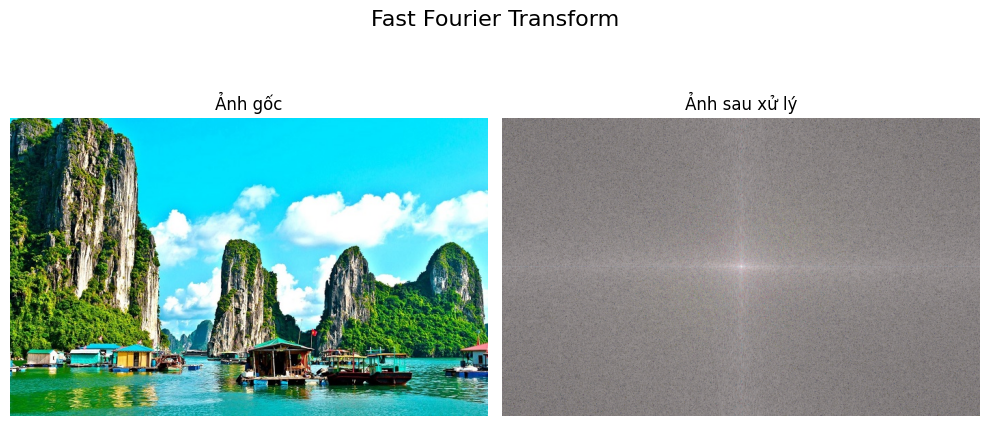

Ảnh đã lưu tại: exercise\fourier_ha-long-bay-in-vietnam.jpg


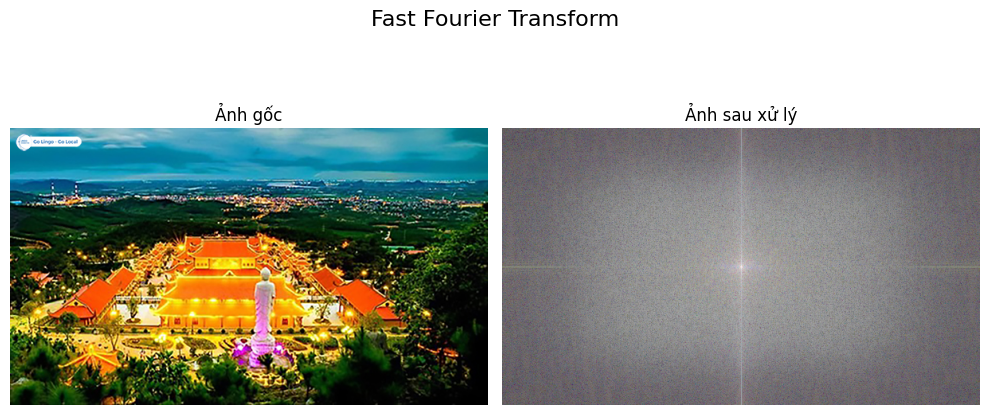

Ảnh đã lưu tại: exercise\fourier_pagoda.jpg


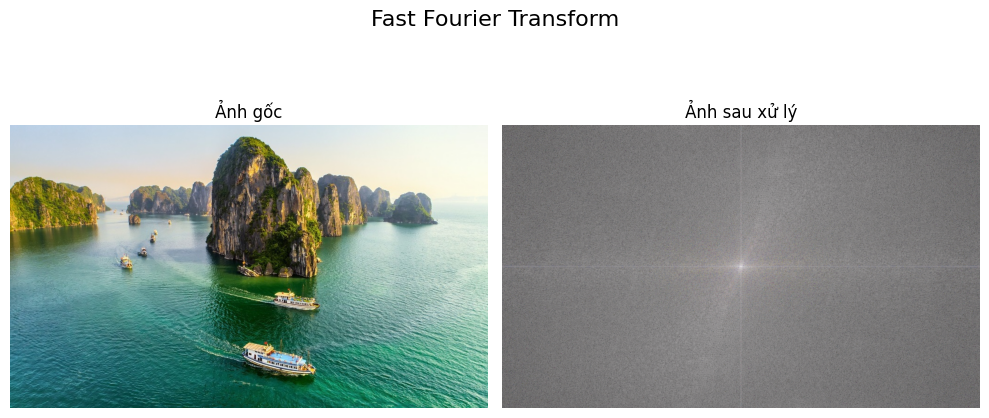

Ảnh đã lưu tại: exercise\fourier_quang_ninh.jpg
F. Fast Fourier
L. Butterworth Low Pass
H. Butterworth High Pass
E. Exit
Bạn đã chọn Butterworth Low Pass.


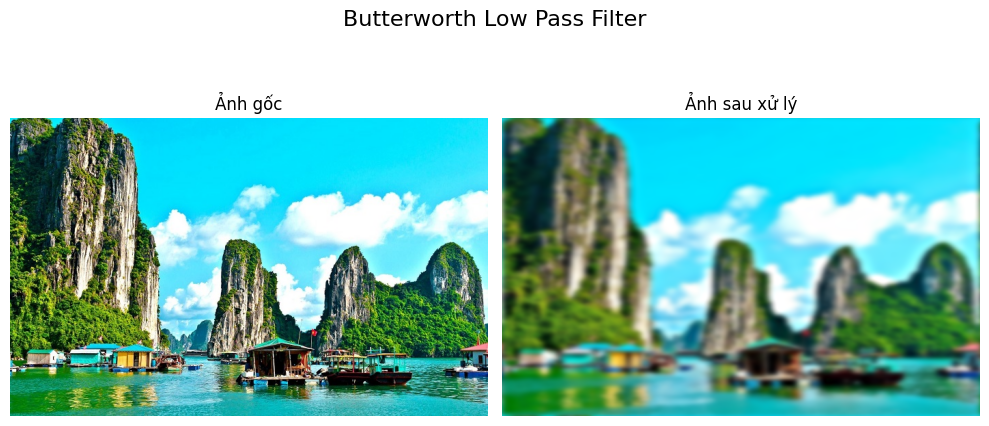

Ảnh đã lưu tại: exercise\lowpass_ha-long-bay-in-vietnam.jpg


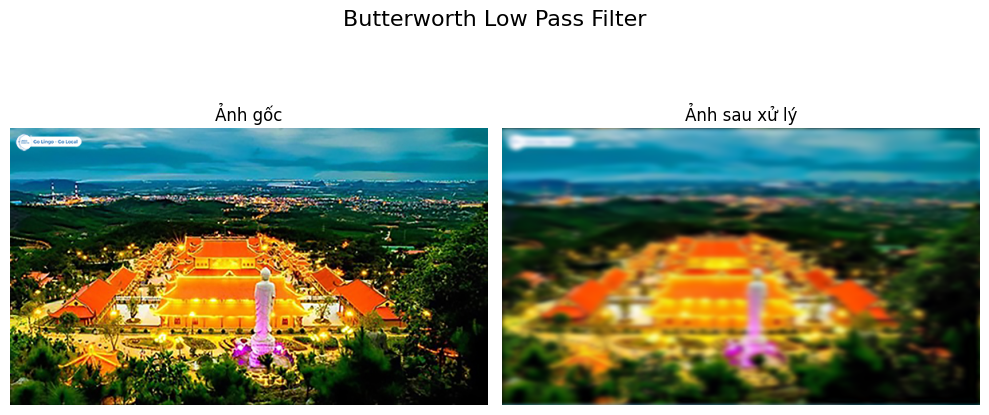

Ảnh đã lưu tại: exercise\lowpass_pagoda.jpg


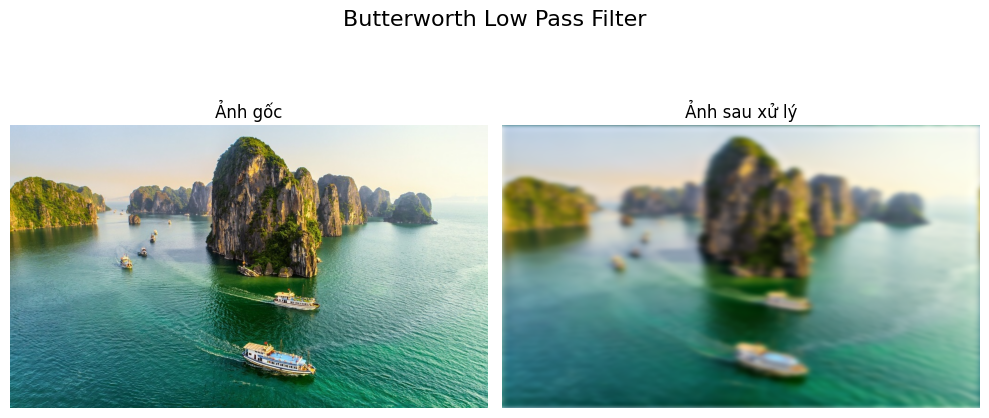

Ảnh đã lưu tại: exercise\lowpass_quang_ninh.jpg
F. Fast Fourier
L. Butterworth Low Pass
H. Butterworth High Pass
E. Exit
Bạn đã chọn Butterworth High Pass.


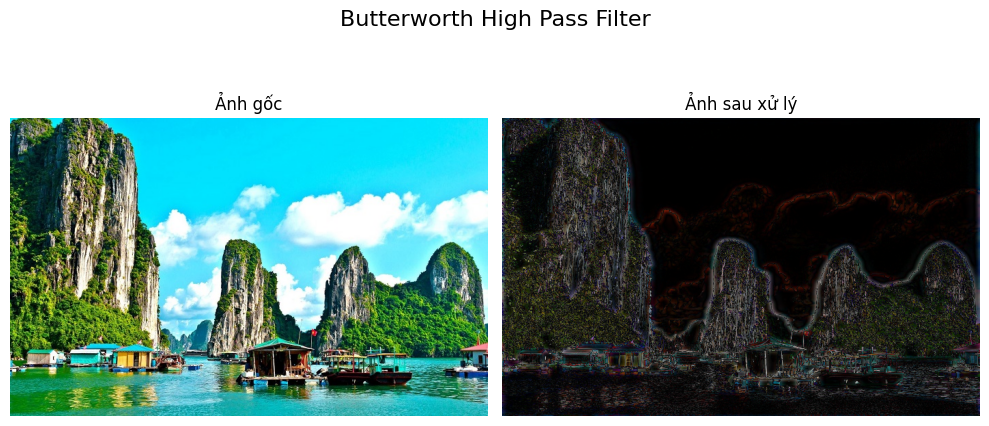

Ảnh đã lưu tại: exercise\highpass_ha-long-bay-in-vietnam.jpg


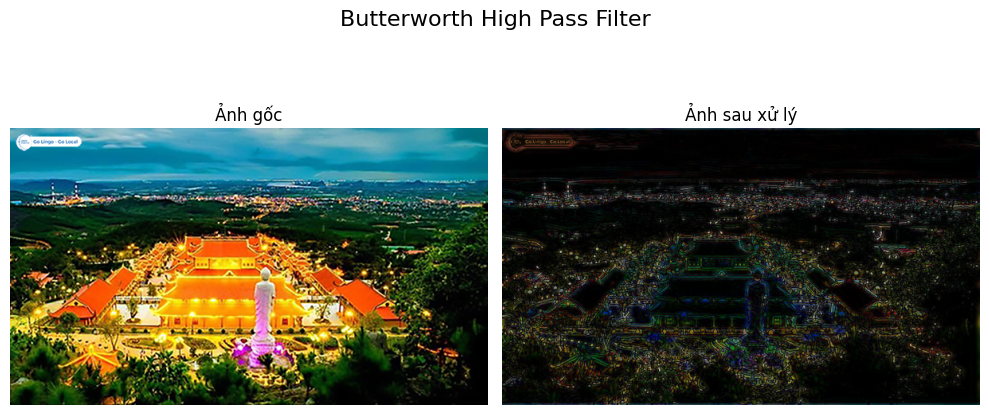

Ảnh đã lưu tại: exercise\highpass_pagoda.jpg


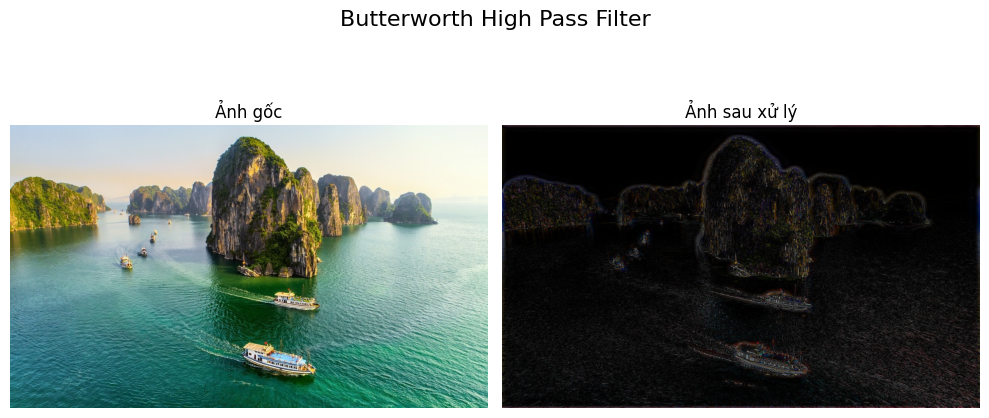

Ảnh đã lưu tại: exercise\highpass_quang_ninh.jpg
F. Fast Fourier
L. Butterworth Low Pass
H. Butterworth High Pass
E. Exit
Bạn đã chọn thoát chương trình.


In [ ]:
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import os
import math
import scipy.fftpack
import imageio.v2 as iio  

def fast_fourier(img_path):
    img = Image.open(img_path).convert('RGB')
    r, g, b = img.split()

    def fft_magnitude(channel):
        im = np.asarray(channel)
        c = np.abs(scipy.fftpack.fft2(im))
        d = scipy.fftpack.fftshift(c)
        d = np.log(1 + d)
        return d / np.max(d) 

    r_fft = fft_magnitude(r)
    g_fft = fft_magnitude(g)
    b_fft = fft_magnitude(b)
    merged = np.stack((r_fft, g_fft, b_fft), axis=-1)
    result_img = (merged * 255).astype(np.uint8)

    show_images(img, result_img, "Fast Fourier Transform")
    save_path = os.path.join("exercise", f"fourier_{os.path.basename(img_path)}")
    iio.imsave(save_path, result_img)
    print(f"Ảnh đã lưu tại: {save_path}")

def butterworth_low_pass(img_path):
    img = Image.open(img_path).convert('RGB')
    r, g, b = img.split()

    def process_channel(channel):
        im = np.asarray(channel)
        M, N = im.shape
        c = scipy.fftpack.fft2(im)
        d = scipy.fftpack.fftshift(c)

        d_0 = 30.0
        n = 2
        H = np.zeros((M, N))
        for u in range(M):
            for v in range(N):
                D = math.sqrt((u - M/2)**2 + (v - N/2)**2)
                H[u, v] = 1 / (1 + (D / d_0)**(2 * n))

        G = d * H
        G = scipy.fftpack.ifftshift(G)
        img_back = abs(scipy.fftpack.ifft2(G))
        return np.clip(img_back, 0, 255).astype(np.uint8)

    r_out = process_channel(r)
    g_out = process_channel(g)
    b_out = process_channel(b)

    result_img = np.stack((r_out, g_out, b_out), axis=-1)
    show_images(img, result_img, "Butterworth Low Pass Filter")
    save_path = os.path.join("exercise", f"lowpass_{os.path.basename(img_path)}")
    iio.imsave(save_path, result_img)
    print(f"Ảnh đã lưu tại: {save_path}")

def butterworth_high_pass(img_path):
    img = Image.open(img_path).convert('RGB')
    r, g, b = img.split()

    def process_channel(channel):
        im = np.asarray(channel)
        M, N = im.shape
        c = scipy.fftpack.fft2(im)
        d = scipy.fftpack.fftshift(c)

        d_0 = 30.0
        n = 2
        H = np.ones((M, N))
        for u in range(M):
            for v in range(N):
                D = math.sqrt((u - M/2)**2 + (v - N/2)**2)
                H[u, v] = 1 / (1 + (d_0 / D)**(2 * n)) if D != 0 else 0

        G = d * H
        G = scipy.fftpack.ifftshift(G)
        img_back = abs(scipy.fftpack.ifft2(G))
        return np.clip(img_back, 0, 255).astype(np.uint8)

    r_out = process_channel(r)
    g_out = process_channel(g)
    b_out = process_channel(b)

    result_img = np.stack((r_out, g_out, b_out), axis=-1)
    show_images(img, result_img, "Butterworth High Pass Filter")
    save_path = os.path.join("exercise", f"highpass_{os.path.basename(img_path)}")
    iio.imsave(save_path, result_img)
    print(f"Ảnh đã lưu tại: {save_path}")

def show_images(original, processed, title=""):
    fig, axs = plt.subplots(1, 2, figsize=(10, 5))
    axs[0].imshow(np.array(original))
    axs[0].set_title('Ảnh gốc')
    axs[0].axis('off')

    axs[1].imshow(processed)
    axs[1].set_title('Ảnh sau xử lý')
    axs[1].axis('off')

    fig.suptitle(title, fontsize=16)
    plt.tight_layout()
    plt.show()

def process_images(image_list, process_function):
    for path in image_list:
        if os.path.isfile(path):
            process_function(path)  
        else:
            print(f"Không tìm thấy ảnh: {path}")

image_list = ['exercise/ha-long-bay-in-vietnam.jpg', 'exercise/pagoda.jpg', 'exercise/quang_ninh.jpg']

while True:
    print("F. Fast Fourier")
    print("L. Butterworth Low Pass")
    print("H. Butterworth High Pass")
    print("E. Exit")
    try:
        choice = input("Mời bạn chọn (F/L/H/E): ").strip().upper()
        if choice == "F":
            print("Bạn đã chọn Fast Fourier.")
            process_images(image_list, fast_fourier)
        elif choice == "L":
            print("Bạn đã chọn Butterworth Low Pass.")
            process_images(image_list, butterworth_low_pass)
        elif choice == "H":
            print("Bạn đã chọn Butterworth High Pass.")
            process_images(image_list, butterworth_high_pass)
        elif choice == "E":
            print("Bạn đã chọn thoát chương trình.")
            break
        else:
            print("Lựa chọn không hợp lệ. Vui lòng chọn lại.")
    except Exception as e:
        print("Lỗi xảy ra:", e)


Bài 3


Mời bạn chọn:
R. Xử lý ngẫu nhiên ảnh trong thư mục
E. Thoát
Bạn đã chọn xử lý ngẫu nhiên.


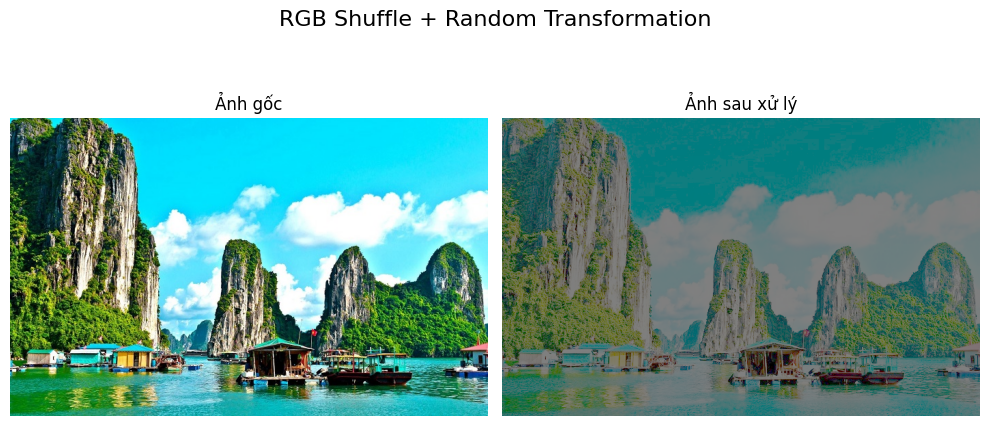

Ảnh đã lưu tại: exercise\modified_ha-long-bay-in-vietnam.jpg


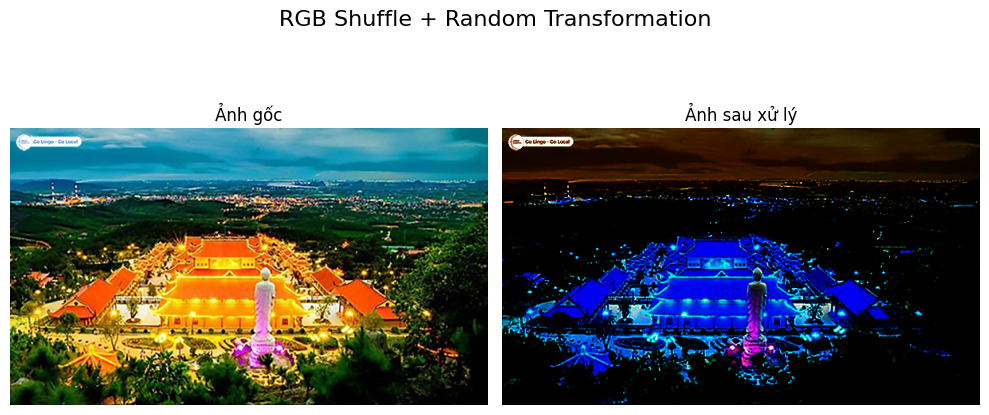

Ảnh đã lưu tại: exercise\modified_pagoda.jpg


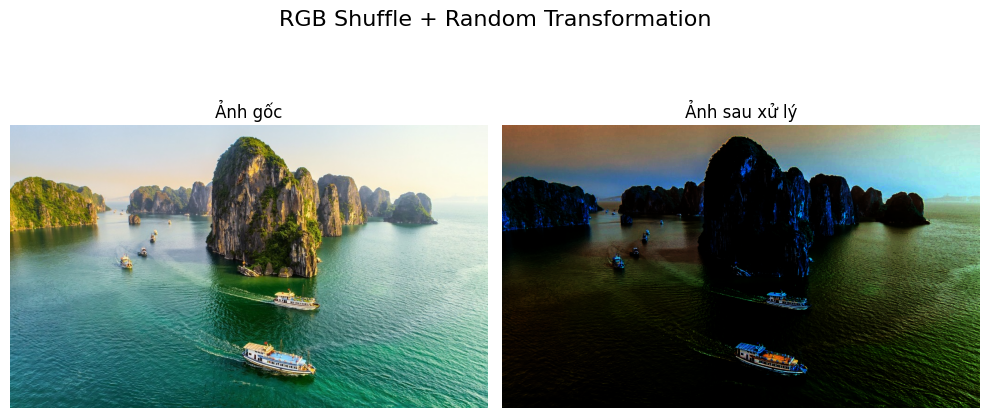

Ảnh đã lưu tại: exercise\modified_quang_ninh.jpg

Mời bạn chọn:
R. Xử lý ngẫu nhiên ảnh trong thư mục
E. Thoát
Bạn đã chọn xử lý ngẫu nhiên.


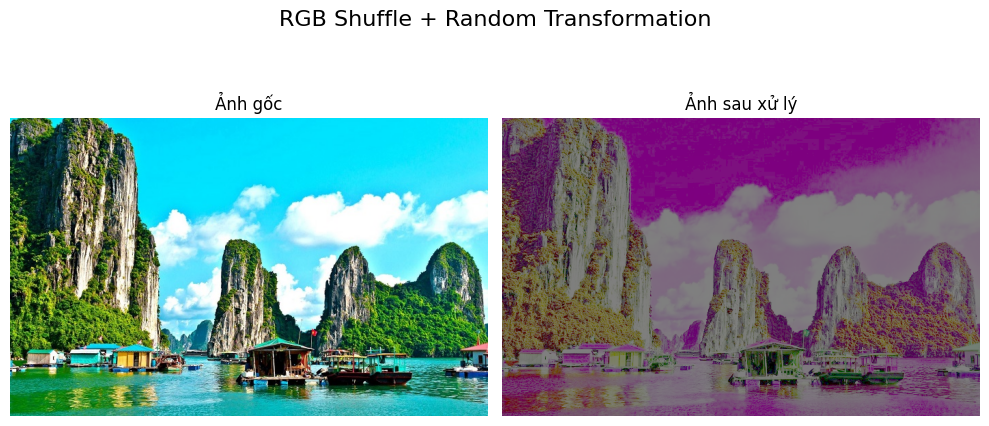

Ảnh đã lưu tại: exercise\modified_ha-long-bay-in-vietnam.jpg


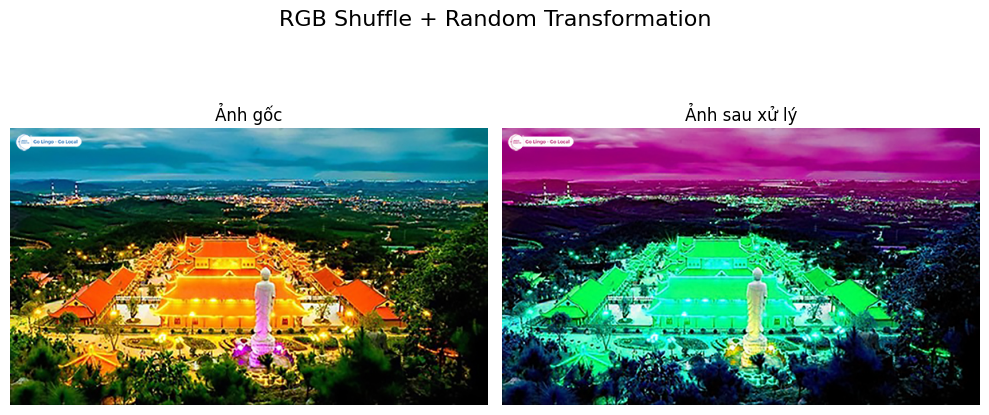

Ảnh đã lưu tại: exercise\modified_pagoda.jpg


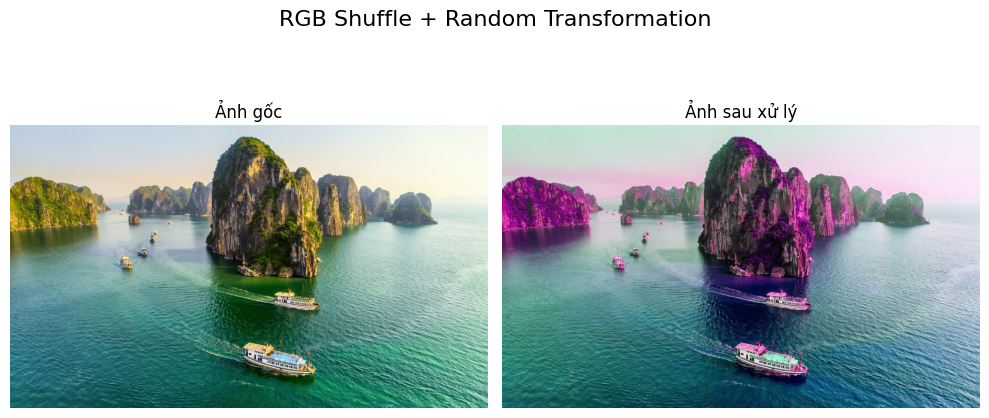

Ảnh đã lưu tại: exercise\modified_quang_ninh.jpg

Mời bạn chọn:
R. Xử lý ngẫu nhiên ảnh trong thư mục
E. Thoát
Thoát chương trình.


In [26]:
from PIL import Image
import numpy as np
import imageio.v2 as iio
import matplotlib.pyplot as plt
import os
import random

def shuffle_rgb_channels(img_array):
    channels = [0, 1, 2]
    random.shuffle(channels)
    return img_array[:, :, channels]

# Các hàm xử lý nhận numpy array
def inverse_array(img):
    return 255 - img

def gamma_correction_array(img, gamma=5):
    b1 = img.astype(float)
    b2 = np.max(b1)
    b3 = b1 / (b2 + 1e-8)
    b2 = np.log(b3 + 1e-8) * gamma
    c = np.exp(b2) * 255.0
    return np.clip(c, 0, 255).astype(np.uint8)

def log_transform_array(img):
    b1 = img.astype(float)
    b2 = np.max(b1)
    c = (128.0 * np.log(1 + b1)) / np.log(1 + b2)
    return np.clip(c, 0, 255).astype(np.uint8)

def histogram_equalization_array(img):
    if len(img.shape) == 3:  # ảnh màu
        img_out = np.zeros_like(img)
        for ch in range(3):
            img_out[:, :, ch] = histogram_equalize_gray(img[:, :, ch])
        return img_out
    else:  # ảnh xám
        return histogram_equalize_gray(img)

def histogram_equalize_gray(gray):
    hist, _ = np.histogram(gray.flatten(), 256, [0, 256])
    cdf = hist.cumsum()
    cdf_m = np.ma.masked_equal(cdf, 0)
    cdf_m = (cdf_m - cdf_m.min()) * 255 / (cdf_m.max() - cdf_m.min())
    cdf_final = np.ma.filled(cdf_m, 0).astype('uint8')
    return cdf_final[gray]

def contrast_stretching_array(img):
    a = img.min()
    b = img.max()
    stretched = 255 * (img.astype(float) - a) / (b - a + 1e-8)
    return np.clip(stretched, 0, 255).astype(np.uint8)

# Hàm gọi 1 phép biến đổi ngẫu nhiên
def random_transformation(img_array):
    functions = [
        inverse_array,
        gamma_correction_array,
        log_transform_array,
        histogram_equalization_array,
        contrast_stretching_array
    ]
    func = random.choice(functions)
    return func(img_array)

# Hiển thị ảnh
def show_images(original, processed, title=""):
    fig, axs = plt.subplots(1, 2, figsize=(10, 5))
    axs[0].imshow(original)
    axs[0].set_title('Ảnh gốc')
    axs[0].axis('off')
    axs[1].imshow(processed)
    axs[1].set_title('Ảnh sau xử lý')
    axs[1].axis('off')
    fig.suptitle(title, fontsize=16)
    plt.tight_layout()
    plt.show()

# Hàm xử lý toàn bộ ảnh
def process_and_save_with_random_transform(image_list):
    for path in image_list:
        if not os.path.isfile(path):
            print(f"Không tìm thấy ảnh: {path}")
            continue

        img = Image.open(path).convert("RGB")
        original_array = np.array(img)
        shuffled = shuffle_rgb_channels(original_array)
        transformed = random_transformation(shuffled)

        show_images(original_array, transformed, "RGB Shuffle + Random Transformation")

        # Lưu ảnh
        save_name = f"modified_{os.path.basename(path)}"
        save_path = os.path.join("exercise", save_name)
        iio.imsave(save_path, transformed)
        print(f"Ảnh đã lưu tại: {save_path}")

# Menu chính
image_list = ['exercise/ha-long-bay-in-vietnam.jpg', 'exercise/pagoda.jpg', 'exercise/quang_ninh.jpg']

while True:
    print("\nMời bạn chọn:")
    print("R. Xử lý ngẫu nhiên ảnh trong thư mục")
    print("E. Thoát")
    try:
        choice = input("Chọn (R/E): ").strip().upper()
        if choice == "R":
            print("Bạn đã chọn xử lý ngẫu nhiên.")
            process_and_save_with_random_transform(image_list)
        elif choice == "E":
            print("Thoát chương trình.")
            break
        else:
            print("Lựa chọn không hợp lệ. Vui lòng chọn lại.")
    except Exception as e:
        print("Lỗi xảy ra:", e)


Bài 4

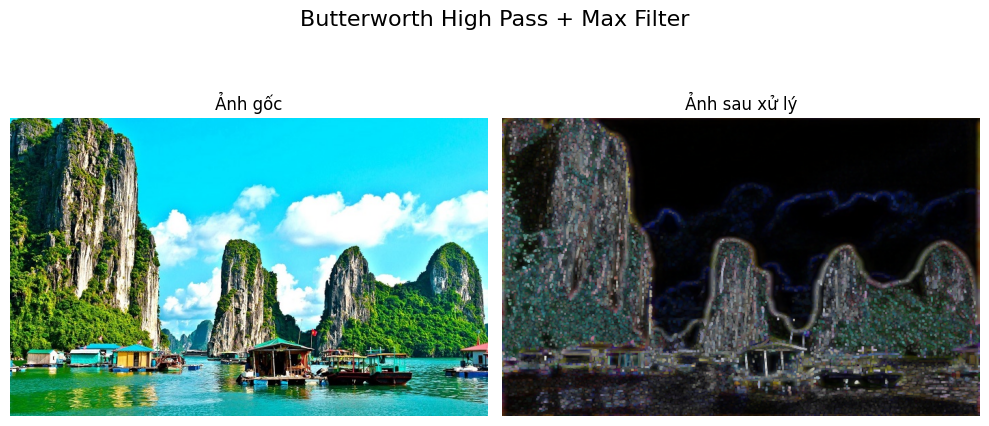

Đã lưu ảnh: exercise\highpass_max_ha-long-bay-in-vietnam.jpg


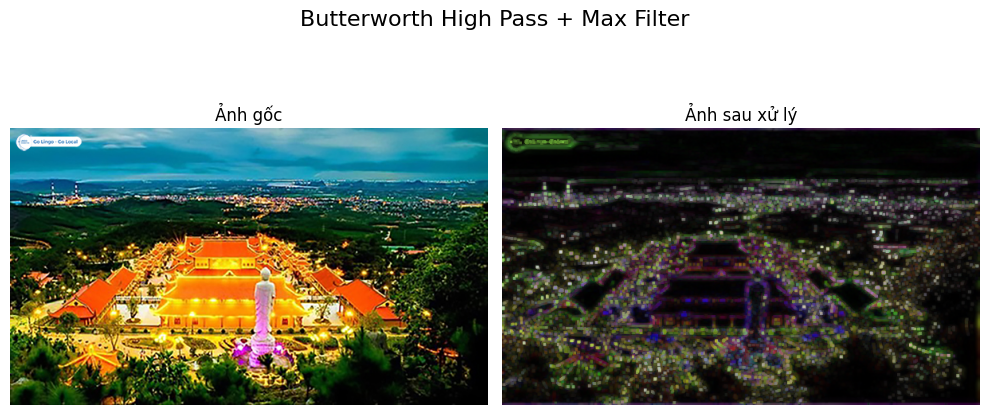

Đã lưu ảnh: exercise\highpass_max_pagoda.jpg


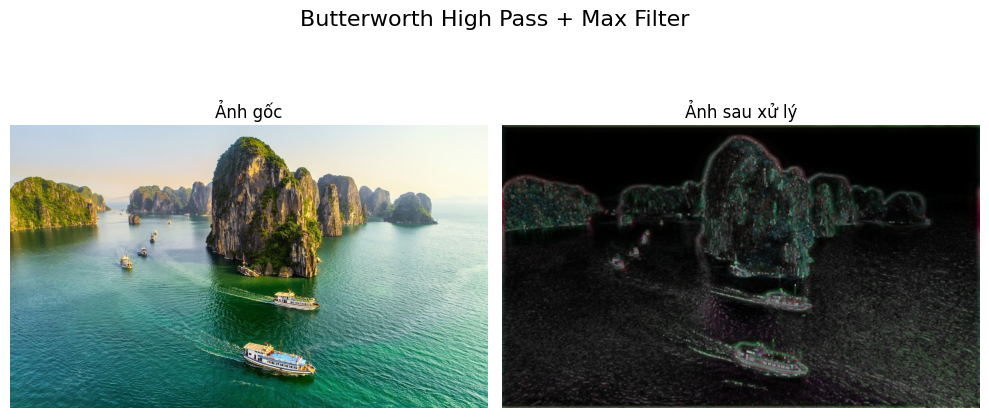

Đã lưu ảnh: exercise\highpass_max_quang_ninh.jpg


In [ ]:
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import os
import math
import scipy.fftpack
import imageio.v2 as iio
import random
from scipy.ndimage import minimum_filter, maximum_filter

def show_images(original, processed, title=""):
    fig, axs = plt.subplots(1, 2, figsize=(10, 5))
    axs[0].imshow(np.array(original))
    axs[0].set_title('Ảnh gốc')
    axs[0].axis('off')

    axs[1].imshow(processed)
    axs[1].set_title('Ảnh sau xử lý')
    axs[1].axis('off')

    fig.suptitle(title, fontsize=16)
    plt.tight_layout()
    plt.show()

def shuffle_rgb_channels(img_array):
    channels = [0, 1, 2]
    random.shuffle(channels)
    return img_array[:, :, channels]

def fast_fourier(img_array):
    def fft_channel(channel):
        c = np.abs(scipy.fftpack.fft2(channel))
        c = scipy.fftpack.fftshift(c)
        return np.log(1 + c)

    r, g, b = img_array[:, :, 0], img_array[:, :, 1], img_array[:, :, 2]
    r_f = fft_channel(r)
    g_f = fft_channel(g)
    b_f = fft_channel(b)

    merged = np.stack((r_f, g_f, b_f), axis=-1)
    return np.clip((merged / np.max(merged)) * 255, 0, 255).astype(np.uint8)

def butterworth_filter(img_array, filter_type='low'):
    def process_channel(channel):
        M, N = channel.shape
        F = scipy.fftpack.fft2(channel)
        F_shifted = scipy.fftpack.fftshift(F)
        d0 = 30.0
        n = 2
        H = np.zeros((M, N))
        for u in range(M):
            for v in range(N):
                D = math.sqrt((u - M/2)**2 + (v - N/2)**2)
                if filter_type == 'low':
                    H[u, v] = 1 / (1 + (D / d0)**(2 * n))
                else:  # high-pass
                    H[u, v] = 1 / (1 + (d0 / D)**(2 * n)) if D != 0 else 0
        G = F_shifted * H
        G = scipy.fftpack.ifftshift(G)
        result = abs(scipy.fftpack.ifft2(G))
        return np.clip(result, 0, 255).astype(np.uint8)

    r = process_channel(img_array[:, :, 0])
    g = process_channel(img_array[:, :, 1])
    b = process_channel(img_array[:, :, 2])
    return np.stack((r, g, b), axis=-1)

def apply_min_filter(img_array):
    return minimum_filter(img_array, size=(3, 3, 1))

def apply_max_filter(img_array):
    return maximum_filter(img_array, size=(3, 3, 1))

image_list = ['exercise/ha-long-bay-in-vietnam.jpg', 'exercise/pagoda.jpg', 'exercise/quang_ninh.jpg']
transformations = ['fourier', 'butter_low', 'butter_high']
choice = random.choice(transformations)
for img_path in image_list:
    if not os.path.isfile(img_path):
        print(f"Không tìm thấy ảnh: {img_path}")
        continue

    img = Image.open(img_path).convert('RGB')
    img_array = np.array(img)
    
    shuffled = shuffle_rgb_channels(img_array)
    
    processed = None
    title = ""

    if choice == 'fourier':
        processed = fast_fourier(shuffled)
        title = "Fast Fourier Transform"
        save_name = f"fourier_{os.path.basename(img_path)}"

    elif choice == 'butter_low':
        processed = butterworth_filter(shuffled, filter_type='low')
        processed = apply_min_filter(processed)
        title = "Butterworth Low Pass + Min Filter"
        save_name = f"lowpass_min_{os.path.basename(img_path)}"

    elif choice == 'butter_high':
        processed = butterworth_filter(shuffled, filter_type='high')
        processed = apply_max_filter(processed)
        title = "Butterworth High Pass + Max Filter"
        save_name = f"highpass_max_{os.path.basename(img_path)}"

    show_images(img, processed, title)
    save_path = os.path.join("exercise", save_name)
    iio.imsave(save_path, processed)
    print(f"Đã lưu ảnh: {save_path}")
